# Relationship between Spending Behaviour and Credit Score
### Wei Lu, Gary Li, Eric Zhang, Samir Shaikh

## Introduction
A credit score is important for one to take out a loan for a house or other assets that require a high-risk purchase. Therefore, being able to know what to spend or save up your money to maintain a high credit score is essential for ensuring that you can purchase these expensive assets. Using past data on other people’s financial decisions and features can show or predict what one should do to keep a high credit score, which is the purpose of this project.

We will try to answer the following questions:

How do spending behaviours may impact one’s credit score?
And can we predict one’s credit score based on spending behaviours?

Our dataset comprises 1000 customers, with 84 features of their financial behaviour used to gauge the data's use in estimating credit risk and potential defaults. 

- CUST_ID: Unique customer identifier
- INCOME: Total income in the last 12 months
- SAVINGS: Total savings in the last 12 months
- DEBT: Total existing debt
- R_SAVINGS_INCOME: Ratio of savings to income
- R_DEBT_INCOME: Ratio of debt to income
- R_DEBT_SAVINGS: Ratio of debt to savings

Detailed descriptions are available on the webpage.
https://www.kaggle.com/datasets/conorsully1/credit-score.

## Methods and Results
- We will first explore the relationships between income, savings, debt, and credit score. If we cannot find a strong correlation/ prediction, we will change the predictors by dividing the predictors into more sub-categories (e.g. Gambling spending, Housing spending, Education spending, etc) and selecting variables that we believe have a stronger impact on credit score.
- Then, with the variables that correlate with credit score, we will use those as predictors to train the regression model
- We will use Linear Regression model to see the performance.
- Finally, we will use v-fold and similar functions to tune KNN regression model and evaluate its performance.

We can visualize our data by plotting our predicted values along the training/ testing model to visualize the trend and relationships.

### Code Initialization

In [2]:
#library and seed
library(tidyverse)
library(tidymodels)
library(repr)
library(GGally)
set.seed(1234569)

Warning message:
“package ‘ggplot2’ was built under R version 4.3.2”
── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5     ✔ rsample      1.2.0
✔ dials        1.2.0     ✔ tune         1.1.2
✔ infer        1.0.5     ✔ workflows    1.1.3
✔ modeldata    1.2.0     ✔ workflowsets 1.0.1
✔ parsnip      1.1.1     ✔ yardstick    1.2.0
✔ recipes      1.0.8     

── Conflicts ───────────────────────────────────────── tidymodels_co

In [3]:
# Data Retrieval
credit_csv <- read_csv("https://raw.githubusercontent.com/Gary050613/dsci100-project/main/data/credit_score.csv?token=GHSAT0AAAAAACQ6K4LTUM5IMMRBZL5ZSCA4ZQ5ZHAA")
head(credit_csv)

Rows: 1000 Columns: 87
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (2): CUST_ID, CAT_GAMBLING
dbl (85): INCOME, SAVINGS, DEBT, R_SAVINGS_INCOME, R_DEBT_INCOME, R_DEBT_SAV...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


CUST_ID,INCOME,SAVINGS,DEBT,R_SAVINGS_INCOME,R_DEBT_INCOME,R_DEBT_SAVINGS,T_CLOTHING_12,T_CLOTHING_6,R_CLOTHING,⋯,R_EXPENDITURE_SAVINGS,R_EXPENDITURE_DEBT,CAT_GAMBLING,CAT_DEBT,CAT_CREDIT_CARD,CAT_MORTGAGE,CAT_SAVINGS_ACCOUNT,CAT_DEPENDENTS,CREDIT_SCORE,DEFAULT
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
C02COQEVYU,33269,0,532304,0.0000,16.0000,1.2000,1889,945,0.5003,⋯,0.0000,0.0625,High,1,0,0,0,0,444,1
C02OZKC0ZF,77158,91187,315648,1.1818,4.0909,3.4615,5818,111,0.0191,⋯,0.7692,0.2222,No,1,0,0,1,0,625,0
C03FHP2D0A,30917,21642,534864,0.7000,17.3000,24.7142,1157,860,0.7433,⋯,1.4286,0.0578,High,1,0,0,1,0,469,1
C03PVPPHOY,80657,64526,629125,0.8000,7.8000,9.7499,6857,3686,0.5376,⋯,1.2500,0.1282,High,1,0,0,1,0,559,0
C04J69MUX0,149971,1172498,2399531,7.8182,16.0000,2.0465,1978,322,0.1628,⋯,0.1163,0.0568,High,1,1,1,1,1,473,0
C04Q46QKOG,181636,339055,1695274,1.8667,9.3334,5.0000,11446,1910,0.1669,⋯,0.3571,0.0714,No,1,0,0,1,0,596,0


##### Table 1

### Explore the most related variables
1. Calculate the variables with the highest correlation with `CREDIT_SCORE`
2. Visualize the variables against `CREDIT_SCORE`

In [7]:
# credit_cor <- cor(credit_csv["CREDIT_SCORE"], credit_csv[,2:85])
# sapply(credit_csv["CAT_GAMBLING"], class)
data_cor <- credit_csv |>
    select(-CUST_ID, -CAT_GAMBLING, -DEFAULT)
# data_cor
data_cor_x <- data_cor |> select(-CREDIT_SCORE)
data_cor_y <- data_cor |> select(CREDIT_SCORE)

credit_cor <- cor(data_cor_x, data_cor_y)
# credit_cor

credit_cor_df <- as_tibble(credit_cor)
credit_cor_df <- cbind(rownames(credit_cor),credit_cor_df) |>
    rename("variable" = "rownames(credit_cor)", "correlation" = "CREDIT_SCORE")
# credit_cor_df

credit_cor_rank <- credit_cor_df |>
    mutate(abs_cor = abs(correlation)) |>
    slice_max(abs_cor, n = 10)
credit_cor_rank

variable,correlation,abs_cor
<chr>,<dbl>,<dbl>
R_DEBT_INCOME,-0.8578997,0.8578997
R_DEBT_SAVINGS,-0.4540681,0.4540681
DEBT,-0.3272315,0.3272315
R_EXPENDITURE_DEBT,0.3075944,0.3075944
R_UTILITIES_DEBT,0.3034817,0.3034817
R_EDUCATION_INCOME,-0.3032684,0.3032684
R_GROCERIES_DEBT,0.2869993,0.2869993
R_TAX_DEBT,0.2842591,0.2842591
R_ENTERTAINMENT_DEBT,0.2799262,0.2799262


##### Table 2

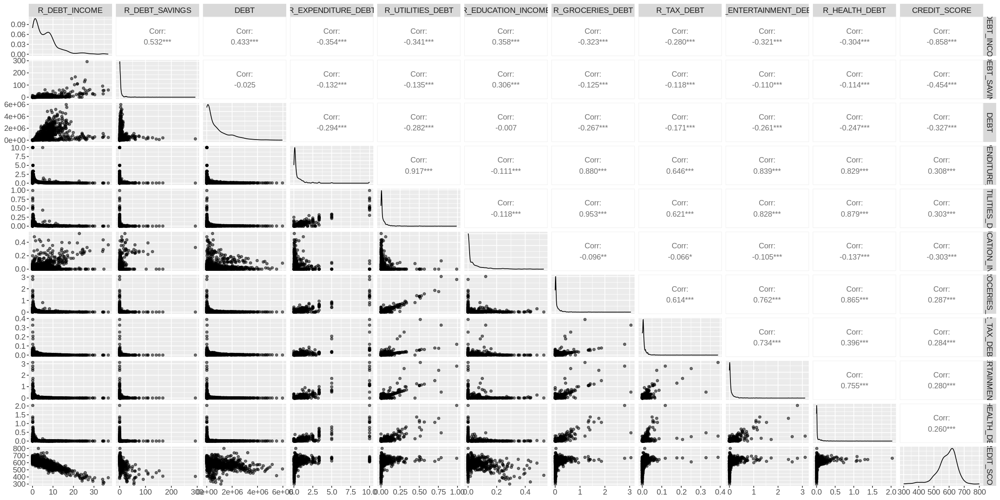

In [8]:
options(repr.plot.width = 20, repr.plot.height = 10)
credit_data <- credit_csv |>
    select(pull(select(credit_cor_rank, variable)), CREDIT_SCORE)
credit_pairs <- credit_data |>
    ggpairs(aes(alpha = 0.05)) +
    theme(text = element_text(size = 14))
credit_pairs

##### Figure 1

#### Observation
From the ggpairs visualization, we can see that `R_DEBT_INCOME` has a roughly negative strong linear relationship with `CREDIT_SCORE`. So we will use Linear Regression to build our model.

### Linear regression

#### Linear regression with one variable (`R_DEBT_INCOME`)

In [26]:
set.seed(1234569)
credit_data_1 <- select(credit_csv, R_DEBT_INCOME, CREDIT_SCORE)
credit_split_1 <- initial_split(credit_data_1, prop = 0.75, strata = CREDIT_SCORE)
credit_train_1 <- training(credit_split_1)
credit_test_1 <- testing(credit_split_1)

lm_spec <- linear_reg() |>
    set_engine("lm") |>
    set_mode("regression")

lm_recipe_1 <- recipe(CREDIT_SCORE ~ R_DEBT_INCOME, data = credit_train_1)

lm_fit_1 <- workflow() |>
    add_recipe(lm_recipe_1) |>
    add_model(lm_spec) |>
    fit(data = credit_train_1)

In [27]:
credit_preds <- lm_fit_1 |>
    predict(credit_test_1) |>
    bind_cols(credit_test_1)
credit_results <- credit_preds |>
    metrics(truth = CREDIT_SCORE, estimate = .pred)
credit_results

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
rmse,standard,32.5715646
rsq,standard,0.7279384
mae,standard,24.6278332


##### Table 3

#### Model Performance
We can see that our model achieved a Root Mean Squared Prediction Error of only 32.57. Bring this into context, since credit scores are out of 850, we have an approximate error of 32.57/850 = 3.8%. Our model has a decent approximation.

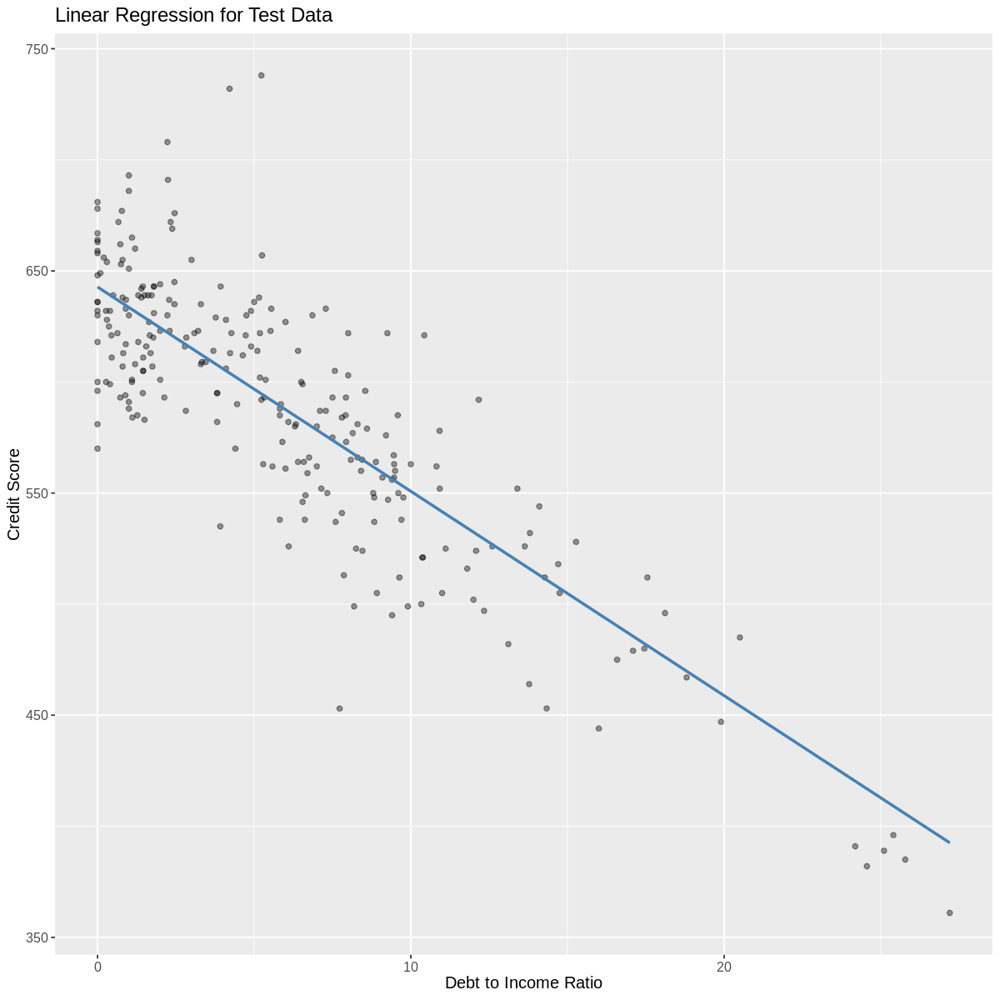

In [28]:
options(repr.plot.width = 10, repr.plot.height = 10)
credit_plot_test <- ggplot(credit_test_1, aes(x = R_DEBT_INCOME, y = CREDIT_SCORE)) +
  geom_point(alpha = 0.4) +
  geom_line(data = credit_preds,
            mapping = aes(x = R_DEBT_INCOME, y = .pred),
            color = "steelblue",
            linewidth = 1) +
  xlab("Debt to Income Ratio") +
  ylab("Credit Score") +
  scale_y_continuous() +
  theme(text = element_text(size = 12)) +
  ggtitle("Linear Regression for Test Data")
credit_plot_test

##### Figure 2

In [29]:
coeffs <- lm_fit_1 |>
    extract_fit_parsnip() |>
    tidy()
coeffs

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),642.777271,1.7041738,377.17825,0.000000e+00
R_DEBT_INCOME,-9.199476,0.2000095,-45.99519,4.151064e-220


##### Table 4

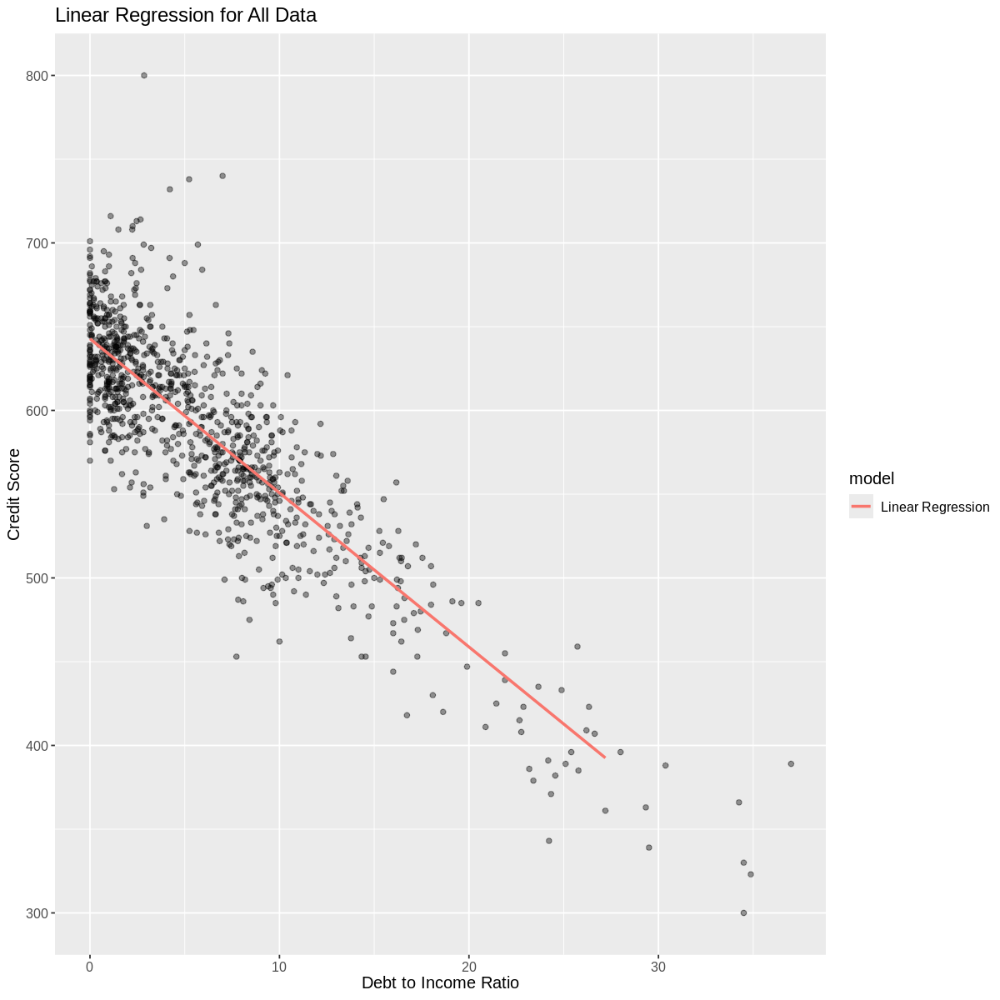

In [30]:
options(repr.plot.width = 10, repr.plot.height = 10)
credit_preds <- mutate(credit_preds, model = "Linear Regression")

credit_plot_final <- ggplot(credit_csv, aes(x = R_DEBT_INCOME, y = CREDIT_SCORE)) +
  geom_point(alpha = 0.4) +
  geom_line(data = credit_preds,
            mapping = aes(x = R_DEBT_INCOME, y = .pred, color=model),            
            linewidth = 1) +
  xlab("Debt to Income Ratio") +
  ylab("Credit Score") +
  scale_y_continuous() +
  theme(text = element_text(size = 12)) +
  ggtitle("Linear Regression for All Data")
credit_plot_final

##### Figure 3

#### Linear regression with two variables
Although the simple linear regression performs well above, we want explore whether multivariable linear regression will perform better or not. We use two predictors: `R_DEBT_INCOME`,`R_DEBT_SAVINGS`

In [31]:
set.seed(1234569)
# data set split
credit_data_2 <- select(credit_csv, R_DEBT_INCOME, R_DEBT_SAVINGS, CREDIT_SCORE)
credit_split_2 <- initial_split(credit_data_2, prop = 0.75, strata = CREDIT_SCORE)
credit_train_2 <- training(credit_split_2)
credit_test_2 <- testing(credit_split_2)

# new recipe
lm_recipe_2 <- recipe(CREDIT_SCORE ~ R_DEBT_INCOME + R_DEBT_SAVINGS, data = credit_train_2)
# train the model
lm_fit_2 <- workflow() |>
    add_recipe(lm_recipe_2) |>
    add_model(lm_spec) |>
    fit(data = credit_train_2)

In [32]:
credit_preds_2 <- lm_fit_2 |>
    predict(credit_test_2) |>
    bind_cols(credit_test_2)
credit_results_2 <- credit_preds_2 |>
    metrics(truth = CREDIT_SCORE, estimate = .pred)
credit_results_2

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
rmse,standard,32.5748722
rsq,standard,0.7278415
mae,standard,24.6339834


##### Table 5

#### Model Performance
With one more predictor, the RMSPE is increased from 32.5715646 to 32.5748722. Considering the random initial split of the data set and the scale of credit score, there is no obvious difference between simple linear regression and multivariable linear regression.

### KNN-regression
Now, we want to know if knn-regression also works well on this data set

#### KNN-regression with one variable

In [33]:
set.seed(1234569)
# knn-regression model
knn_spec_1 <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("regression")

# knn-regression recipe
knn_recipe_1 <- recipe(CREDIT_SCORE ~ R_DEBT_INCOME,
                          data = credit_train_1)

# use 5 fold validation on credit_train_1
train_1_vfold <- vfold_cv(credit_train_1, v = 5, strata = CREDIT_SCORE)

knn_fit_1 <- workflow() |>
    add_recipe(knn_recipe_1) |>
    add_model(knn_spec_1)
# knn_fit_1
gridvals <- tibble(neighbors = seq(from = 1, to = 100))

knn_result_1 <- knn_fit_1 |>
    tune_grid(resamples = train_1_vfold, grid = gridvals) |>
    collect_metrics() |>
    filter(.metric == "rmse") |>
    filter(mean == min(mean))
knn_result_1

neighbors,.metric,.estimator,mean,n,std_err,.config
<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
24,rmse,standard,33.7125,5,1.532988,Preprocessor1_Model024


##### Table 6

Since the knn works best with 24 neighbors on the training data. Next, we need to see how it works on the testing data.

In [34]:
k_best <- knn_result_1 |> pull(neighbors) # the best k

knn_best_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = k_best) |>
    set_engine("kknn") |>
    set_mode("regression")

knn_fit_best <- workflow() |>
    add_recipe(knn_recipe_1) |>
    add_model(knn_best_spec) |>
    fit(credit_train_1)

knn_best_summary <- knn_fit_best |>
  predict(credit_test_1) |>
  bind_cols(credit_test_1) |>
  metrics(truth = CREDIT_SCORE, estimate = .pred) |>
  filter(.metric == 'rmse')
knn_best_summary

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
rmse,standard,33.09174


##### Table 7

#### Model Performance
The RMSPE of knn model is 33.09, very close to 32.57. Therefore, the knn model also performs well on this data set with one variable.

#### Visualization

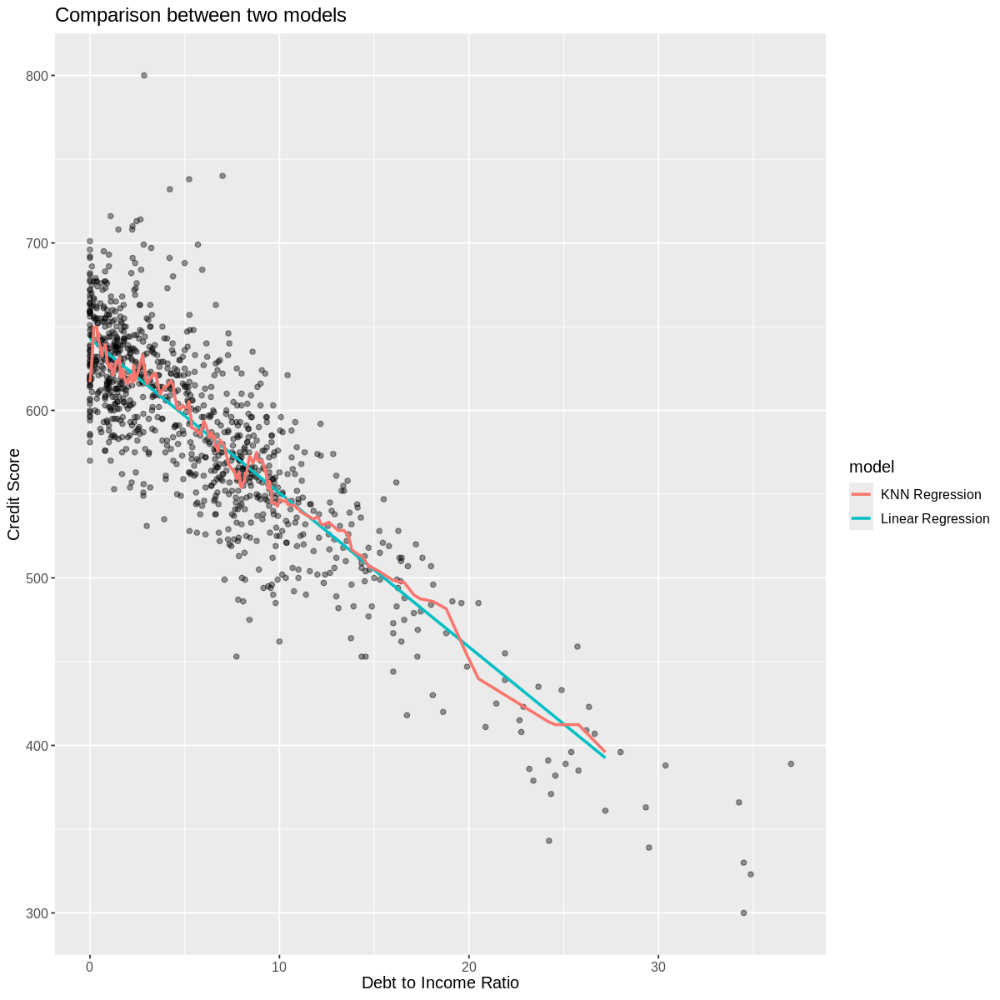

In [35]:
options(repr.plot.width = 10, repr.plot.height = 10)
knn_preds <- knn_fit_best |>
    predict(credit_test_1) |>
    bind_cols(credit_test_1) |>
    mutate(model="KNN Regression")


# knn_preds
credit_compare_plot <- credit_plot_final +
    geom_line(data = knn_preds,
            mapping = aes(x = R_DEBT_INCOME, y = .pred, color = model),
            linewidth = 1) +
    ggtitle('Comparison between two models')
credit_compare_plot

##### Figure 4

## Discussion


#### Findings
- Performance of models
  
In this project, we explored three models: simple linear regression, multivariable linear regression, and K-nearest neighbour regressions. The RMSPE for each model is 32.57, 32.57, and 33.09 (Table 3, 5, 7). Considering that the credit score is out of 850, the error of each model is roughly 3.8 ~ 3.9%. All of them have acceptable performance in predicting credit scores. 

Due to the limitations of KNN model (slow training at large data; bad performance out of the training range), linear models are better choices. The similar performance and one-variable make simple linear model stand out. The coefficeints of the simple linear model are 642.777271 and -9.199476 (Table 4). Given a ratio of debt to income, we easily predict the credit score accurately using only two coefficients. 

- Contribution of variables
  
First, we find that the ratio of debt to income has the greatest absolute value in the Pearson correlation (-0.8578) (Table 2). The second is the ratio of debt to savings (-0.4540) (Table 2). We hypothesized that the multivariable model can outcompete the simple model. However, there is no big difference between the two linear models regarding the RMSPE. The Pearson correlation measures the linear correlation between variables. The strong linear correlation explains why a single variable, `R_DEBT_INCOME`, is enough for the model. The second variable, `R_DEBT_SAVINGS`, doesn't improve the model due to its poor linear correlation.

#### Comparison with what we expect
In the proposal, we expect there are multiple variables relevant to `CREDIT_SCORE`. This matches our outcome (Table 2). However, it is unexpected that only `R_DEBT_INCOME` has a strong negative relationship with `CREDIT_SCORE`. The rest of the variables have weak correlations. Among the top 10 relevant variables, 9 variables are linked to debt. This indicates that debt may play an important role in credit scores. This always makes sense in the real world. As one's Debt-to-income ratio increases, one's Credit Score goes down. An increased ratio indicates that their ability to pay back the debt keeps decreasing, which may be how financial institutions assess credit scores.

#### Significance
Credit score prediction is a tricky problem for individuals. In the last decade, many social lending platforms emerged. It is difficult for lenders and borrowers to assess credit risk without the help of financial institutes (Moscato et al., 2021). Our model at least provides an easy and effective method to assess the risk. These findings allow for an understanding of how financial decisions on debt can impact one’s credit score. By controlling the ratio of debt to income, individuals can maintain a relatively high credit score. Companies can also utilize this model when assessing whether services should be offered. The model may even be used by governments when determining whether support services should be supplied.

#### Future Study
- This study focuses on linear correlations. However, other relationships between variables may exist.
- We performed a multivariable linear model with at most two variables. Different combinations of predictors may decrease the RMSPE.
- This study also contributes to the impact of debt on credit score. Debt-related variables could be further studied via other methods.
- This study didn't address Categorical variables, and there may be different relationships for users in different categories. 

## References


Conor. (2023, December 22). Credit score. Kaggle. https://www.kaggle.com/datasets/conorsully1/credit-score 

Kabacoff, R. (2015). R in action: Data analysis and graphics with R (Second ed.). Manning.

Moscato, V., Picariello, A., & Sperlí, G. (2021). A benchmark of machine learning approaches for credit score prediction. Expert Systems with Applications, 165, 113986. https://doi.org/10.1016/j.eswa.2020.113986